# Notebook to visualise cNMF analysis on diseased small intestine cells
Analysis by Simon Koplev

In [1]:
import numpy as np
import pandas as pd
import os
import scanpy as sc

import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn

In [2]:
adata_raw = sc.read('/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.smallintestine.h5ad')

Only considering the two last: ['.smallintestine', '.h5ad'].
Only considering the two last: ['.smallintestine', '.h5ad'].


In [3]:
adata_raw.obs = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/h5ad/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.smallintestine.cNMF.csv", index_col=0)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,73,75,82,83,84,86,95,100,101,106,108,109,111,119,123,124,125,126,127,128,129,130,131,132) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


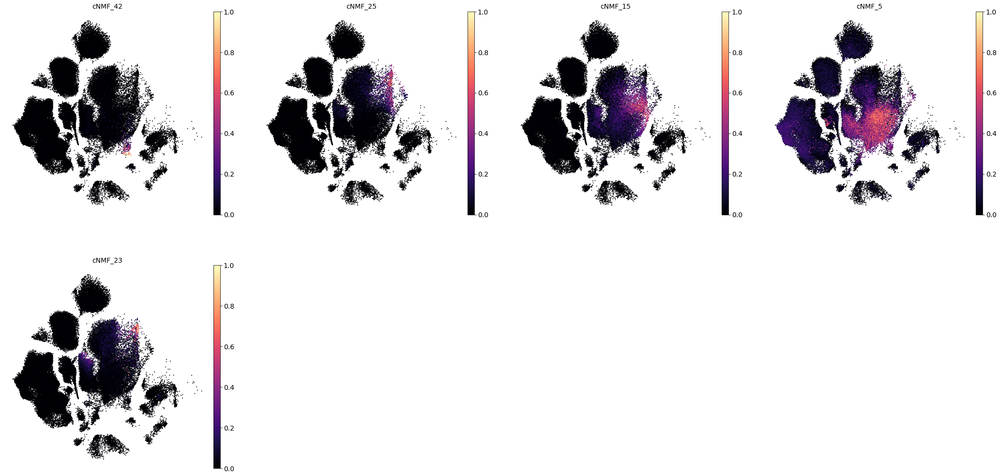

In [4]:
# UMAP plots colored by cNMF usage
sc.set_figure_params(dpi_save=900, figsize=(8, 8))

# without outline
sc.pl.umap(
    adata_raw,
    color=['cNMF_42','cNMF_25','cNMF_15', "cNMF_5",'cNMF_23'],
    #palette='tab20',
    #palette=sc.plotting.palettes.godsnot_102,
    cmap='magma',
    frameon=False,
    vmax=1.0,
    vmin=0.0,
    size=15,  # point size
)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


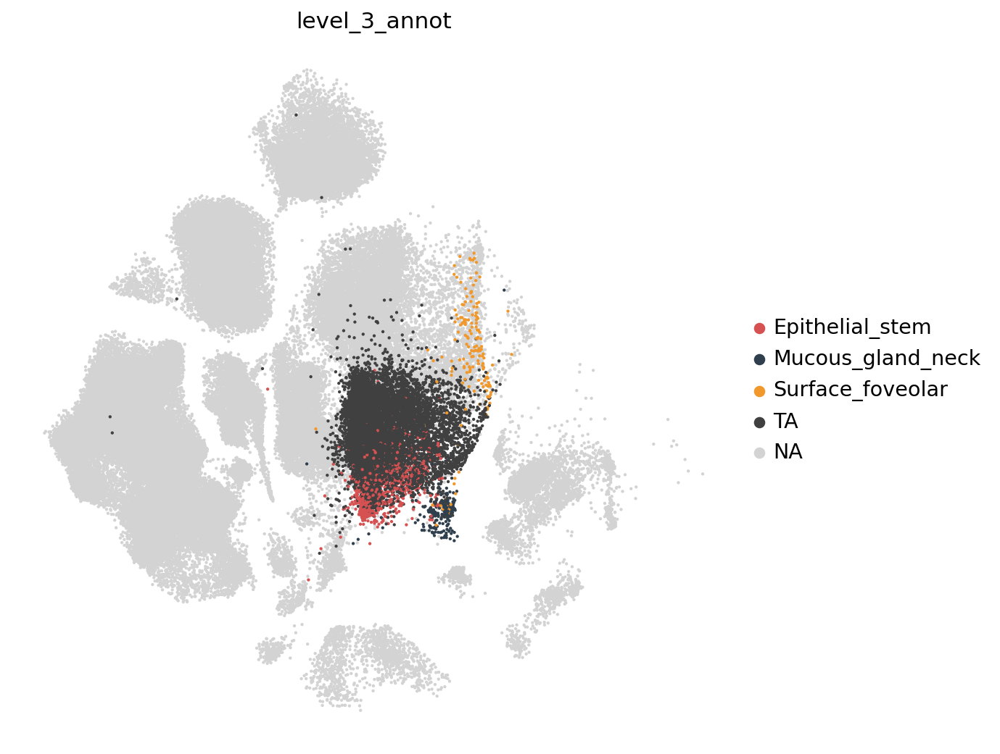

In [5]:
# UMAP plots colored by cNMF usage
sc.set_figure_params(dpi_save=900, figsize=(8, 8))

# without outline
sc.pl.umap(
    adata_raw,
    color=["level_3_annot"], groups=["Surface_foveolar", "Mucous_gland_neck", "Epithelial_stem", "TA"],
    #palette='tab20',
    #palette=sc.plotting.palettes.godsnot_102,
    cmap='magma',
    frameon=False,
    vmax=1.0,
    vmin=0.0,
    size=15,  # point size
)

In [6]:
# without outline
sc.pl.umap(
    adata_raw,
    color=['cNMF_1','cNMF_2','cNMF_3','cNMF_4', "cNMF_5",'cNMF_6','cNMF_7','cNMF_8','cNMF_9','cNMF_10','cNMF_11',
           'cNMF_12','cNMF_13','cNMF_14','cNMF_15','cNMF_16','cNMF_17','cNMF_18','cNMF_19','cNMF_20','cNMF_21','cNMF_22',
          'cNMF_23','cNMF_24','cNMF_25','cNMF_26','cNMF_27','cNMF_28','cNMF_29','cNMF_30','cNMF_31','cNMF_32','cNMF_33',
           'cNMF_34','cNMF_35','cNMF_36','cNMF_37','cNMF_38','cNMF_39','cNMF_40','cNMF_41','cNMF_42','cNMF_43','cNMF_44'],
    #palette='tab20',
    #palette=sc.plotting.palettes.godsnot_102,
    cmap='magma',
    frameon=False,
    vmax=1.0,
    vmin=0.0,
    size=15,  # point size
)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


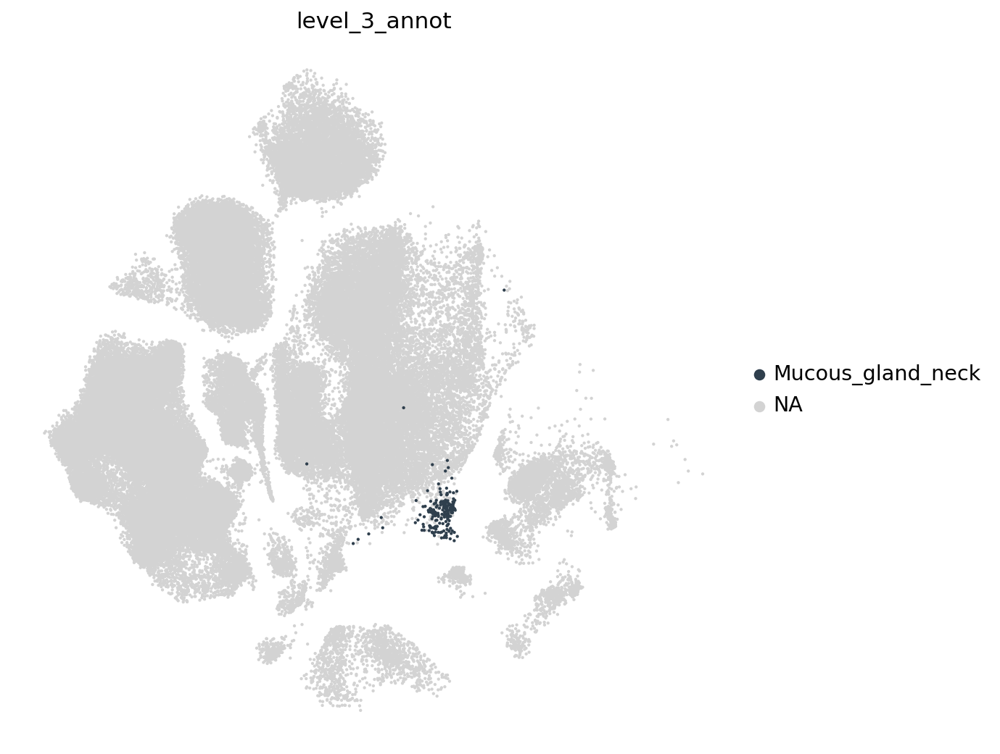

In [7]:
# UMAP plots colored by cNMF usage
sc.set_figure_params(dpi_save=900, figsize=(8, 8))

# without outline
sc.pl.umap(
    adata_raw,
    color=["level_3_annot"], groups=["Mucous_gland_neck"],
    #palette='tab20',
    #palette=sc.plotting.palettes.godsnot_102,
    cmap='magma',
    frameon=False,
    vmax=1.0,
    vmin=0.0,
    size=15,  # point size
)

In [8]:
adata_raw.obs["level_1_annot"].unique()

['B and B plasma', 'T and NK cells', 'Epithelial', 'Endothelial', 'Mesenchymal', 'Myeloid', 'Neural']
Categories (7, object): ['B and B plasma', 'Endothelial', 'Epithelial', 'Mesenchymal', 'Myeloid', 'Neural', 'T and NK cells']

In [9]:
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_3_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[0].to_list(), "B and B plasma")
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_cNMF_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[1].to_list(), "Endothelial")
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_cNMF_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[3].to_list(), "Mesenchymal")
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_cNMF_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[4].to_list(), "Myeloid")
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_cNMF_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[5].to_list(), "Neural")
adata_raw.obs["level_cNMF_annot"] = adata_raw.obs["level_cNMF_annot"].replace(adata_raw.obs["level_3_annot"].groupby(adata_raw.obs["level_1_annot"]).unique()[6].to_list(), "T and NK cells")

In [10]:
adata_raw.obs["level_cNMF_annot"].unique().to_list()

['B and B plasma',
 'T and NK cells',
 'Goblet_cycling',
 'TA',
 'Endothelial',
 'Mesenchymal',
 'Goblet_progenitor',
 'Enterocyte',
 'Myeloid',
 'Epithelial_stem',
 'Enteroendocrine',
 'Microfold',
 'Goblet',
 'BEST4_enterocyte_colonocyte',
 'Tuft',
 'Neural',
 'Paneth',
 'Mucous_gland_neck',
 'Surface_foveolar']

In [11]:
adata_raw.obs["level_cNMF_annot"] = pd.Categorical(adata_raw.obs["level_cNMF_annot"], 
                            categories=[

                                        
  'Epithelial_stem','TA', 'Paneth','Goblet_progenitor','Goblet_cycling','Goblet',
 'Enterocyte','Enteroendocrine','Microfold','Tuft',
  'BEST4_enterocyte_colonocyte','Mucous_gland_neck', 'Surface_foveolar',
                                'B and B plasma','Endothelial','Mesenchymal','Myeloid','Neural',
 'T and NK cells', ], 
                            ordered=True)

In [12]:
colors = {'Epithelial_stem': '#c924b9', 'Enterocyte': '#e1b5e6',
'Surface_foveolar': '#d9b74a',
'Mucous_gland_neck': '#f7b37c',
'TA': '#b85f1c',
'Goblet_cycling': '#d1d14f',
'BEST4_enterocyte_colonocyte': '#39997c',
'Tuft': '#9d9dff',
'Paneth': '#79508f',
'Goblet_progenitor': '#e9f7ad',
'Goblet': '#6c9939',
'Enteroendocrine': '#68b7fc',
'Microfold': '#e55b85',
'B and B plasma':'#5fb494ff',
'Endothelial':'#e98345ff',
'Mesenchymal':  '#f269a3ff',
'Myeloid': '#948ec4ff',
'Neural': '#be9351ff',
'T and NK cells':   '#8bba56ff'} 

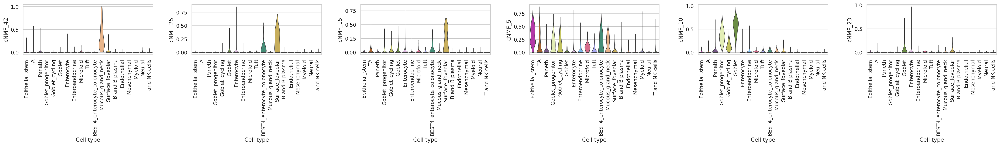

In [13]:
# Plot cell type violin plots for all cNMF factors
rcParams['figure.figsize'] = 5,2
seaborn.set(style='whitegrid')
sc.pl.violin(
        adata_raw,
        keys=['cNMF_42','cNMF_25','cNMF_15', "cNMF_5", 'cNMF_10','cNMF_23'],
        groupby='level_cNMF_annot',
        palette= colors,
        xlabel='Cell type',
        rotation=90,
        linewidth=0.75,
        stripplot=False,
        save='figure_megagut_smallintestine_cNMF_usage.pdf'  # in ./figures
)

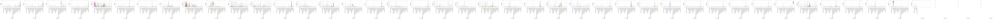

In [14]:
sc.pl.violin(
        adata_raw,
        keys=['cNMF_1','cNMF_2','cNMF_3','cNMF_4', "cNMF_5",'cNMF_6','cNMF_7','cNMF_8','cNMF_9','cNMF_10','cNMF_11',
           'cNMF_12','cNMF_13','cNMF_14','cNMF_15','cNMF_16','cNMF_17','cNMF_18','cNMF_19','cNMF_20','cNMF_21','cNMF_22',
          'cNMF_23','cNMF_24','cNMF_25','cNMF_26','cNMF_27','cNMF_28','cNMF_29','cNMF_30','cNMF_31','cNMF_32','cNMF_33',
           'cNMF_34','cNMF_35','cNMF_36','cNMF_37','cNMF_38','cNMF_39','cNMF_40','cNMF_41','cNMF_42','cNMF_43','cNMF_44'],
        groupby='level_cNMF_annot',
        palette= colors,
        xlabel='Cell type',
        rotation=90,
        linewidth=0.75,
        stripplot=False,
        #save='figure_megagut_smallintestine_cNMF_usage.pdf'  # in ./figures
)

In [15]:
#filter out cells from controls (control, neighbouring samples, treated celiac)
ibd = adata_raw[~adata_raw.obs.disease.isin(['control','neighbouring_inflammed','neighbouring_polyps','neighbouring_cancer','celiac_treated'])].copy()

In [16]:
ibd

AnnData object with n_obs × n_vars = 99465 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

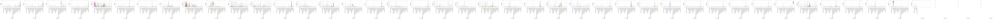

In [17]:
sc.pl.violin(
       ibd,
        keys=['cNMF_1','cNMF_2','cNMF_3','cNMF_4', "cNMF_5",'cNMF_6','cNMF_7','cNMF_8','cNMF_9','cNMF_10','cNMF_11',
           'cNMF_12','cNMF_13','cNMF_14','cNMF_15','cNMF_16','cNMF_17','cNMF_18','cNMF_19','cNMF_20','cNMF_21','cNMF_22',
          'cNMF_23','cNMF_24','cNMF_25','cNMF_26','cNMF_27','cNMF_28','cNMF_29','cNMF_30','cNMF_31','cNMF_32','cNMF_33',
           'cNMF_34','cNMF_35','cNMF_36','cNMF_37','cNMF_38','cNMF_39','cNMF_40','cNMF_41','cNMF_42','cNMF_43','cNMF_44'],
        groupby='level_cNMF_annot',
        palette= colors,
        xlabel='Cell type',
        rotation=90,
        linewidth=0.75,
        stripplot=False,
        save='figure_megagut_smallintestine_cNMF_usage_IBDonly.pdf'  # in ./figures
)

### Visualisation of overlapping factors

In [18]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('5', ascending=False)
df.reset_index(drop=True, inplace=True)

In [19]:
replacement_dict = {
    value: value if value in ["OLFM4", "RGMB", "LEFTY1","KLF5","SOX9", "LGR5","EPHB2", "ASCL2", "HNF4A","SLC12A2"] else "Other"
    for value in df["Unnamed: 0"].unique()
}

# Replace the values in column '1'
df["Unnamed: 0"] = df["Unnamed: 0"].replace(replacement_dict)

In [20]:
df.columns = ['Gene', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
       '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35',
       '36', '37', '38', '39', '40', '41', '42', '43', '44']

In [21]:
df = df.dropna()

In [22]:
df

,Gene,1,2,3,4,5,6,7,8,9,...,35,36,37,38,39,40,41,42,43,44
0,Other,-0.000272,-0.000656,-0.000704,-0.000334,0.002879,-0.000186,-0.000076,-0.000157,-0.000528,...,-0.000102,-0.000300,-0.000179,-0.000034,0.000472,-0.000255,-0.000103,0.000003,0.000125,-0.000164
1,Other,-0.000730,0.002381,0.008608,-0.000424,0.001939,0.001864,-0.003542,-0.000865,-0.000100,...,-0.001134,-0.000628,0.000337,0.000022,-0.000345,-0.001094,0.001868,-0.000270,-0.001080,-0.002530
2,SLC12A2,-0.002525,-0.001904,-0.001707,-0.001378,0.001939,-0.000822,-0.000698,-0.000240,0.001364,...,-0.000346,0.000336,-0.000214,-0.000190,0.000034,-0.000067,-0.000347,0.000232,0.000302,-0.000187
3,Other,-0.003052,-0.002175,-0.003368,-0.001691,0.001828,-0.001164,-0.000667,0.001290,0.000990,...,0.001881,0.000537,-0.000611,0.000115,-0.000255,-0.000419,-0.000736,-0.000291,-0.000085,-0.000277
4,OLFM4,-0.002715,-0.001876,-0.002324,-0.001451,0.001812,-0.000740,-0.000842,-0.000248,0.001912,...,-0.000364,0.000291,-0.000402,-0.000279,-0.000064,-0.000165,-0.000508,0.000513,-0.000258,-0.000447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18097,Other,0.004460,-0.001644,-0.000850,0.000604,-0.001055,-0.001561,0.007064,-0.000151,-0.000865,...,0.000744,-0.000268,-0.000556,0.000229,-0.000209,-0.000826,0.001250,-0.000364,0.000672,-0.001970
18098,Other,-0.000367,-0.002216,-0.002127,-0.001700,-0.001105,-0.000519,0.001090,-0.000441,-0.000368,...,0.000035,-0.000215,-0.000250,-0.000046,-0.000020,-0.000306,-0.000213,0.000399,-0.000225,-0.000551
18099,Other,0.004064,0.005098,-0.004899,0.007087,-0.001117,0.001703,0.002165,-0.000367,-0.000938,...,-0.000045,-0.000094,-0.000241,-0.000874,-0.000511,-0.001236,0.001733,-0.000179,-0.001244,-0.002481
18100,Other,-0.000962,-0.002467,-0.002538,-0.001851,-0.001149,-0.000890,0.000991,-0.000101,-0.000155,...,0.000070,0.000173,-0.000182,-0.000178,0.000060,-0.000264,-0.000277,0.000322,-0.000031,-0.000567


In [23]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

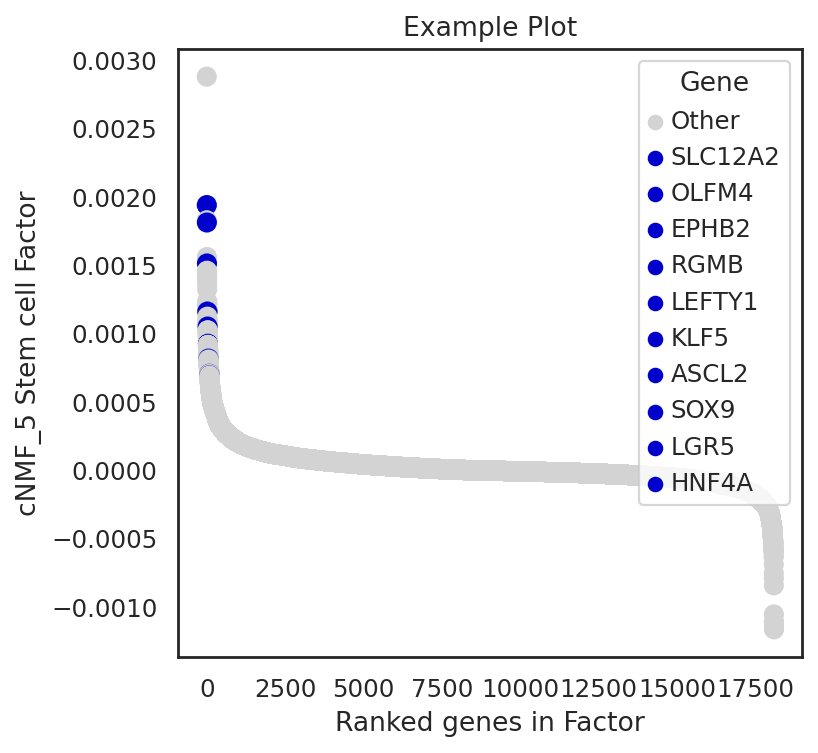

In [24]:
colors = {'OLFM4' : "#0000CD", 'RGMB' : "#0000CD", 'LEFTY1' : '#0000CD',
          'KLF5':"#0000CD",'SOX9':"#0000CD", 'LGR5':"#0000CD", "HNF4A":"#0000CD",
          'SLC12A2':"#0000CD", 'Other':'#D3D3D3', 'ASCL2' : "#0000CD", 'EPHB2' : "#0000CD"}

rcParams['figure.figsize'] = 5,5
seaborn.set(style='white')
ax = seaborn.scatterplot(x=df.index, y="5", data=df, palette=colors, hue=df["Gene"], s=70, edgecolor=None)
plt.title('Example Plot')
# Set x-axis label
plt.xlabel('Ranked genes in Factor')
# Set y-axis label
plt.ylabel('cNMF_5 Stem cell Factor')
plt.savefig("/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/figures/Factor_5.pdf",  bbox_inches='tight')

In [25]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('42', ascending=False)
df.reset_index(drop=True, inplace=True)

In [26]:
replacement_dict = {
    value: value if value in ['PGC','TFF2','AQP5','MUC6','GP2','BPIFB1','TCN1', "CXCL17"] else "Other"
    for value in df["Unnamed: 0"].unique()
}

# Replace the values in column '1'
df["Unnamed: 0"] = df["Unnamed: 0"].replace(replacement_dict)

In [27]:
df["Unnamed: 0"][0:10].to_list()

['PGC',
 'TFF2',
 'AQP5',
 'Other',
 'Other',
 'Other',
 'MUC6',
 'CXCL17',
 'GP2',
 'BPIFB1']

In [28]:
df.columns = ['Gene', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
       '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35',
       '36', '37', '38', '39', '40', '41', '42', '43', '44']

In [29]:
df = df.dropna()

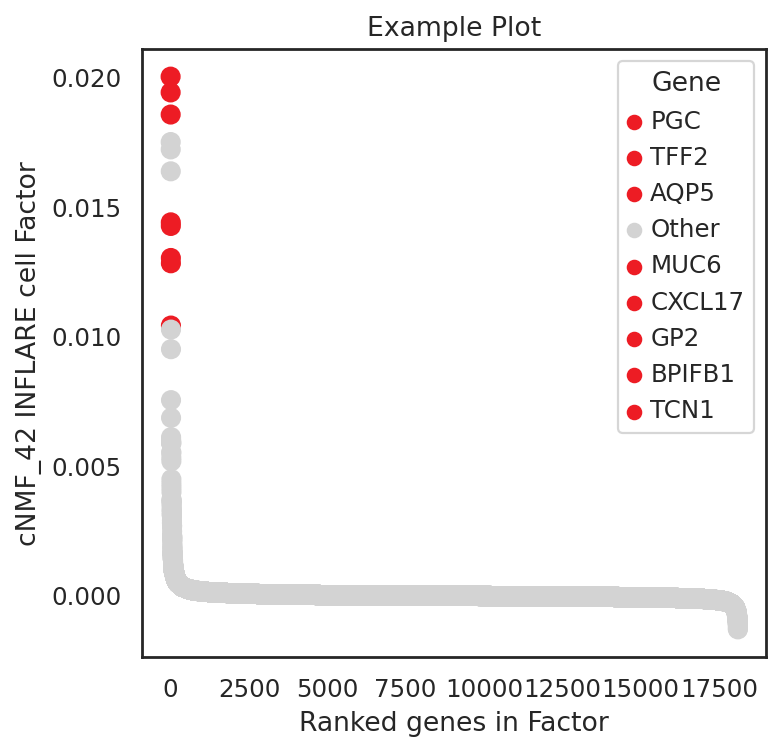

In [30]:
colors = {'PGC' : "#ED1C24", 'TFF2' : "#ED1C24", 'AQP5' : '#ED1C24','MUC6':"#ED1C24",'GP2':"#ED1C24",
          'BPIFB1':"#ED1C24", 'TCN1':"#ED1C24",  'CXCL17':"#ED1C24", 'Other':'#D3D3D3',}

rcParams['figure.figsize'] = 5,5
seaborn.set(style='white')
ax = seaborn.scatterplot(x=df.index, y="42", data=df, palette=colors, hue=df["Gene"], s=70, edgecolor=None)
plt.title('Example Plot')
# Set x-axis label
plt.xlabel('Ranked genes in Factor')
# Set y-axis label
plt.ylabel('cNMF_42 INFLARE cell Factor')
plt.savefig("/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/figures/Factor_42.pdf",  bbox_inches='tight')

In [31]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('10', ascending=False)
df.reset_index(drop=True, inplace=True)



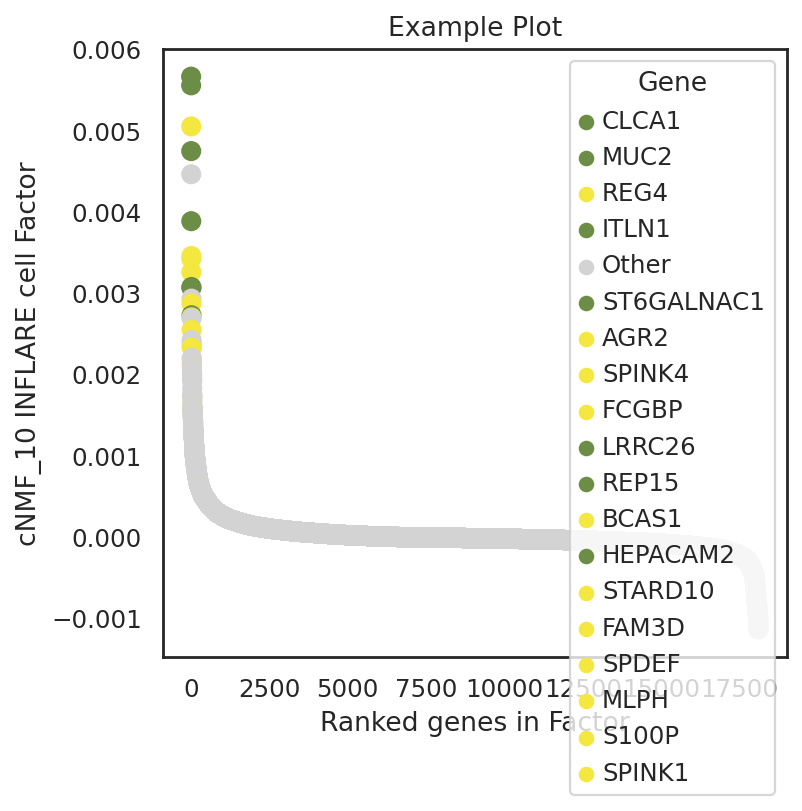

In [32]:
replacement_dict = {
    value: value if value in ['CLCA1', 'MUC2','ITLN1',
 'ST6GALNAC1','LRRC26','REP15','HEPACAM2', 'REG4','BCAS1',"FCGBP","SPINK4",
 'AGR2',"SPINK1","S100P", "FAM3D", "MLPH",'STARD10','FAM3D', "SPDEF", ] else "Other"
    for value in df["Unnamed: 0"].unique()
}

# Replace the values in column '1'
df["Unnamed: 0"] = df["Unnamed: 0"].replace(replacement_dict)

df.columns = ['Gene', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
       '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35',
       '36', '37', '38', '39', '40', '41', '42', '43', '44']

df = df.dropna()

colors = {'Other':'#D3D3D3','CLCA1':'#6B8D45', 'MUC2':'#6B8D45','ITLN1':'#6B8D45',
 'ST6GALNAC1':'#6B8D45','LRRC26':'#6B8D45','REP15':'#6B8D45','HEPACAM2':'#6B8D45', 
          'REG4':'#F4E740','BCAS1':'#F4E740',"FCGBP":'#F4E740',"SPINK4":'#F4E740',
 'AGR2':'#F4E740',"SPINK1":'#F4E740',"S100P":'#F4E740', "FAM3D":'#F4E740', "MLPH":'#F4E740','STARD10':'#F4E740'
          ,'FAM3D':'#F4E740', "SPDEF":'#F4E740', }

rcParams['figure.figsize'] = 5,5
seaborn.set(style='white')
ax = seaborn.scatterplot(x=df.index, y="10", data=df, palette=colors, hue=df["Gene"], s=70, edgecolor=None)
plt.title('Example Plot')
# Set x-axis label
plt.xlabel('Ranked genes in Factor')
# Set y-axis label
plt.ylabel('cNMF_10 INFLARE cell Factor')
plt.savefig("/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/figures/Factor_10.pdf",  bbox_inches='tight')

In [33]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('15', ascending=False)
df.reset_index(drop=True, inplace=True)


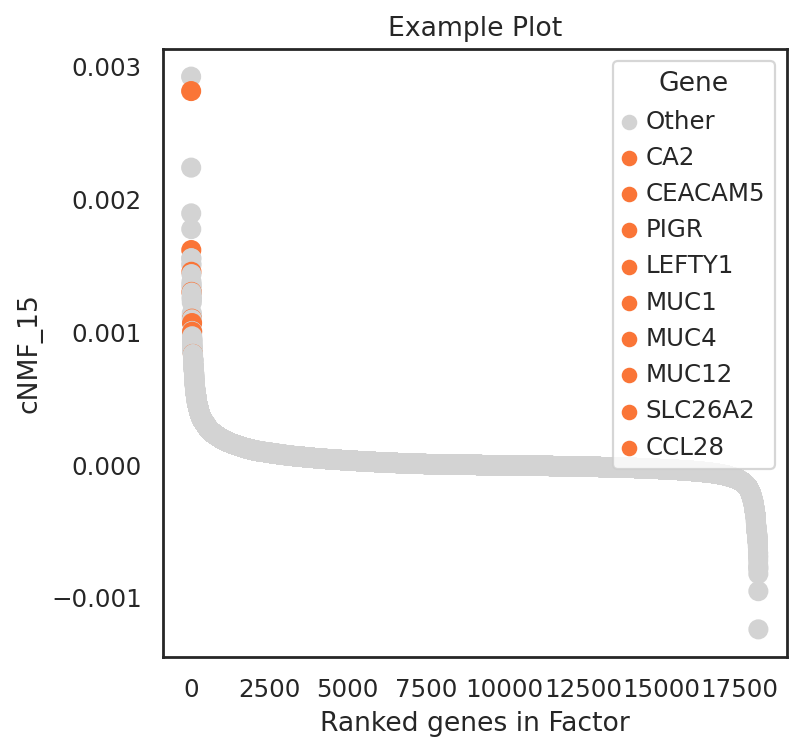

In [34]:
replacement_dict = {
    value: value if value in ['CA2','CEACAM5','PIGR','LEFTY1','MUC1','MUC4','MUC12','SLC26A2','CCL28'] else "Other"
    for value in df["Unnamed: 0"].unique()
}

# Replace the values in column '1'
df["Unnamed: 0"] = df["Unnamed: 0"].replace(replacement_dict)

df.columns = ['Gene', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
       '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35',
       '36', '37', '38', '39', '40', '41', '42', '43', '44']

df = df.dropna()

colors = {'Other':'#D3D3D3','CA2':'#fa7537','CEACAM5':'#fa7537','PIGR':'#fa7537','LEFTY1':'#fa7537','MUC1':'#fa7537',
          'MUC4':'#fa7537','MUC12':'#fa7537','SLC26A2':'#fa7537','CCL28':'#fa7537'}

rcParams['figure.figsize'] = 5,5
seaborn.set(style='white')
ax = seaborn.scatterplot(x=df.index, y="15", data=df, palette=colors, hue=df["Gene"], s=70, edgecolor=None)
plt.title('Example Plot')
# Set x-axis label
plt.xlabel('Ranked genes in Factor')
# Set y-axis label
plt.ylabel('cNMF_15')
plt.savefig("/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/figures/Factor_15.pdf",  bbox_inches='tight')

In [35]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('25', ascending=False)
df.reset_index(drop=True, inplace=True)

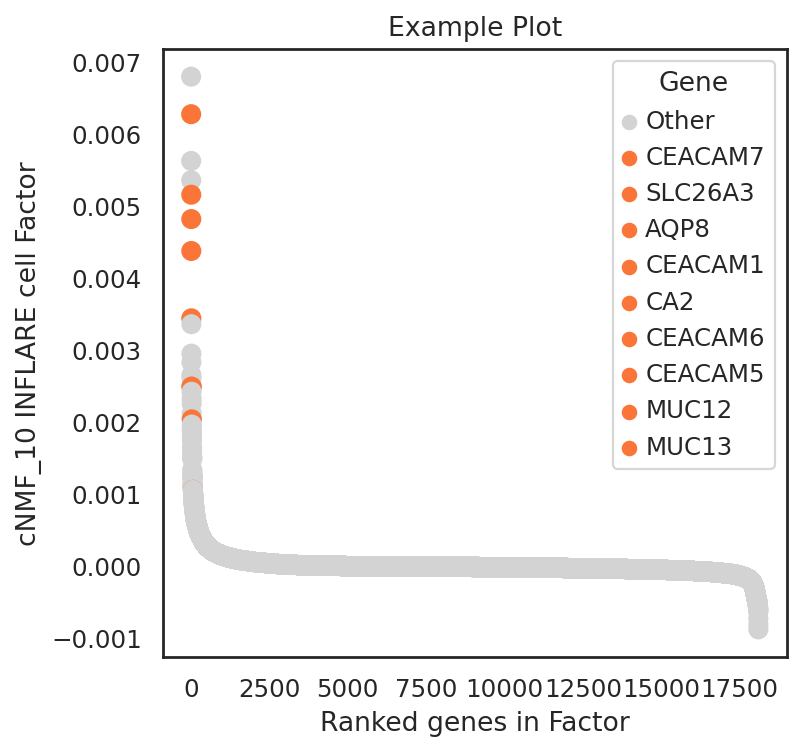

In [36]:
replacement_dict = {
    value: value if value in ['CEACAM7','SLC26A3','AQP8','CEACAM1','CA2','CEACAM6','CEACAM5','MUC12','MUC13'] else "Other"
    for value in df["Unnamed: 0"].unique()
}

# Replace the values in column '1'
df["Unnamed: 0"] = df["Unnamed: 0"].replace(replacement_dict)

df.columns = ['Gene', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
       '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35',
       '36', '37', '38', '39', '40', '41', '42', '43', '44']

df = df.dropna()

colors = {'Other':'#D3D3D3','CEACAM7':'#fa7537','SLC26A3':'#fa7537','AQP8':'#fa7537','CEACAM1':'#fa7537','CA2':'#fa7537',
          'CEACAM6':'#fa7537',
          'CEACAM5':'#fa7537','MUC12':'#fa7537','MUC13':'#fa7537'}

rcParams['figure.figsize'] = 5,5
seaborn.set(style='white')
ax = seaborn.scatterplot(x=df.index, y="25", data=df, palette=colors, hue=df["Gene"], s=70, edgecolor=None)
plt.title('Example Plot')
# Set x-axis label
plt.xlabel('Ranked genes in Factor')
# Set y-axis label
plt.ylabel('cNMF_10 INFLARE cell Factor')
plt.savefig("/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/figures/Factor_25.pdf",  bbox_inches='tight')

         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


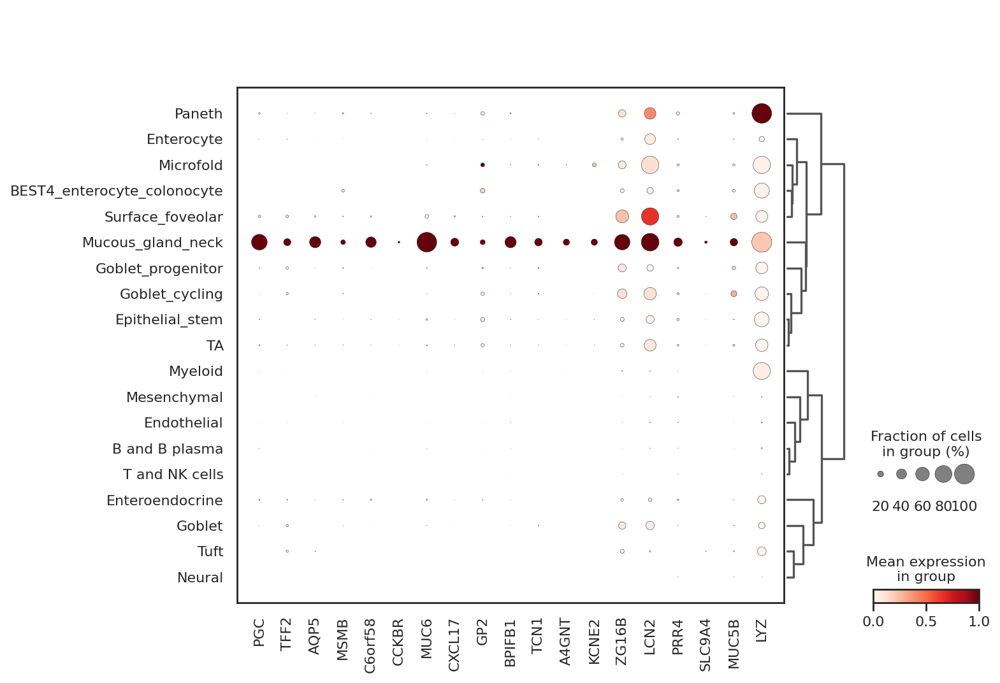

In [37]:
sc.pl.dotplot(adata_raw, ['PGC',
 'TFF2',
 'AQP5',
 'MSMB',
 'C6orf58',
 'CCKBR',
 'MUC6',
 'CXCL17',
 'GP2',
 'BPIFB1',
 'TCN1',
 'A4GNT',
 'KCNE2',
 'ZG16B',
 'LCN2',
 'PRR4',
 'SLC9A4',
 'MUC5B',
 'LYZ'], groupby="level_cNMF_annot", standard_scale="var", dendrogram=True)

In [38]:
df_genes = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_top_genes.csv")

In [39]:
df_genes["10"][0:10].to_list()

['CLCA1',
 'MUC2',
 'REG4',
 'ITLN1',
 'TFF3',
 'ST6GALNAC1',
 'AGR2',
 'SPINK4',
 'FCGBP',
 'LRRC26']

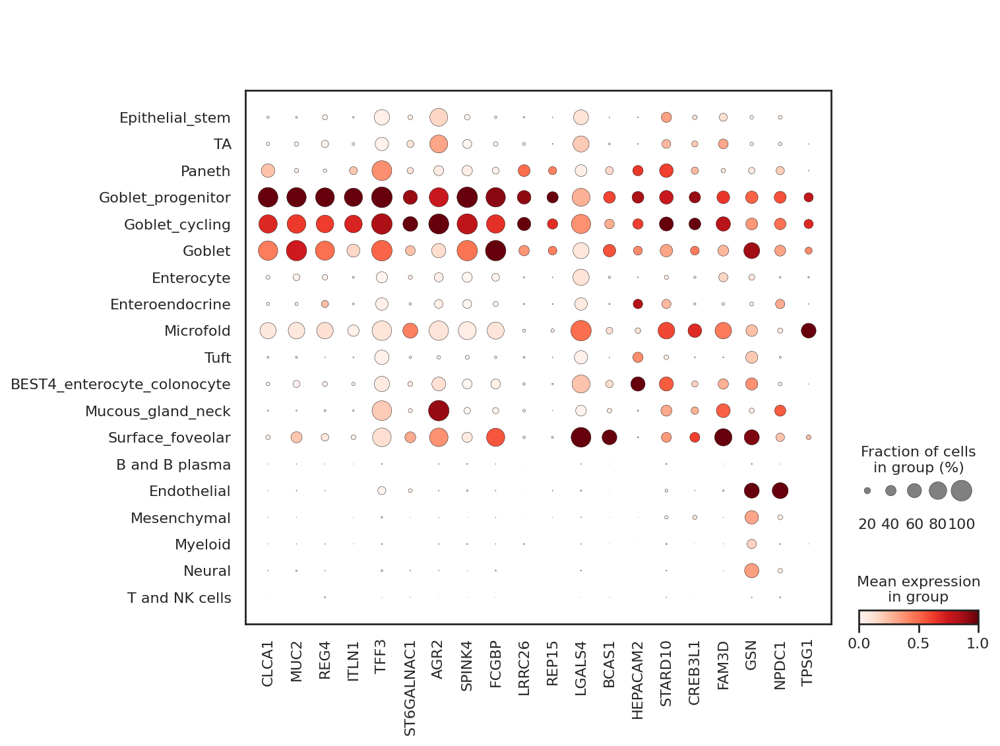

In [40]:
sc.pl.dotplot(adata_raw, df_genes["10"][0:20].to_list(), groupby="level_cNMF_annot", standard_scale="var")

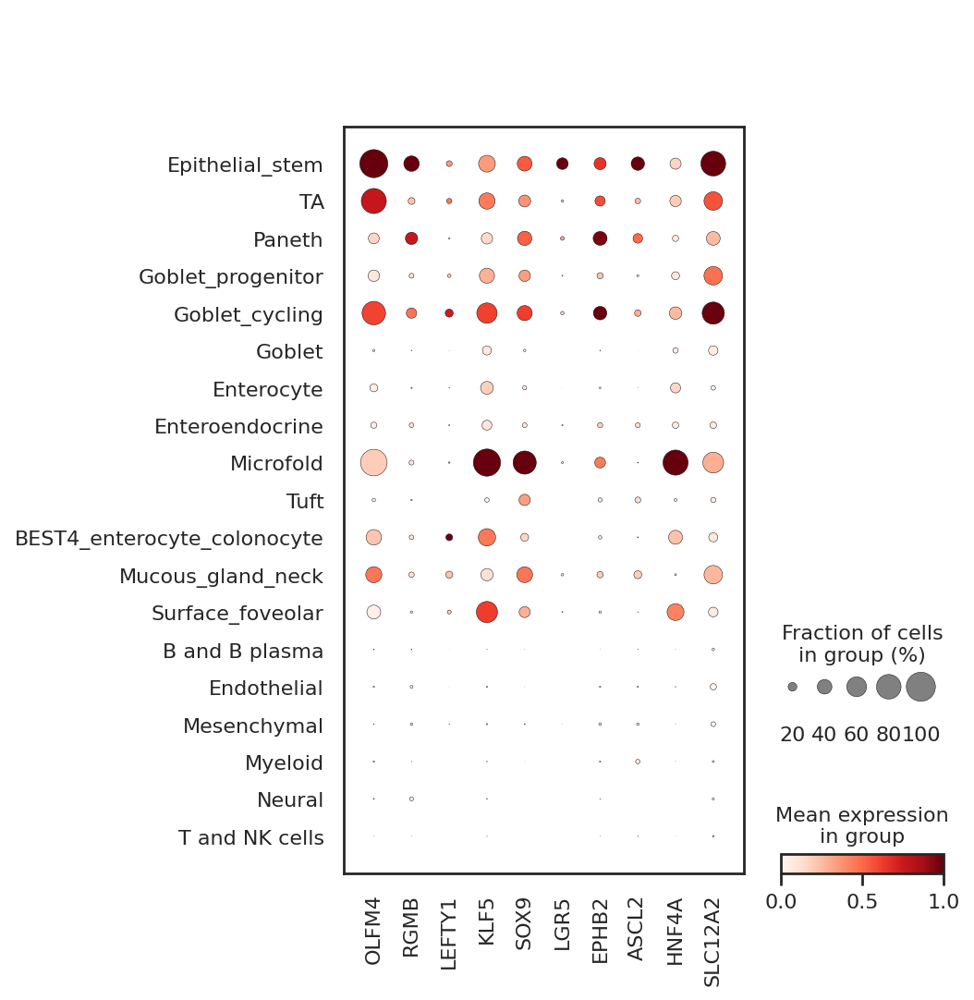

In [41]:
sc.pl.dotplot(adata_raw, ["OLFM4", "RGMB", "LEFTY1","KLF5","SOX9", "LGR5"
                          ,"EPHB2", "ASCL2", "HNF4A","SLC12A2"], groupby="level_cNMF_annot", standard_scale="var")

In [42]:
df = pd.read_csv("/lustre/scratch126/cellgen/team205/sk29/megagut/cNMF/results/cNMF_k44_spectra.csv")
df = df.sort_values('25', ascending=False)
df.reset_index(drop=True, inplace=True)

In [43]:
df["Unnamed: 0"][0:10].tolist()

['ADIG',
 'CEACAM7',
 'MS4A12',
 'CKB',
 'SLC26A3',
 'AQP8',
 'CEACAM1',
 'CA2',
 'EMP1',
 'SLC26A2']

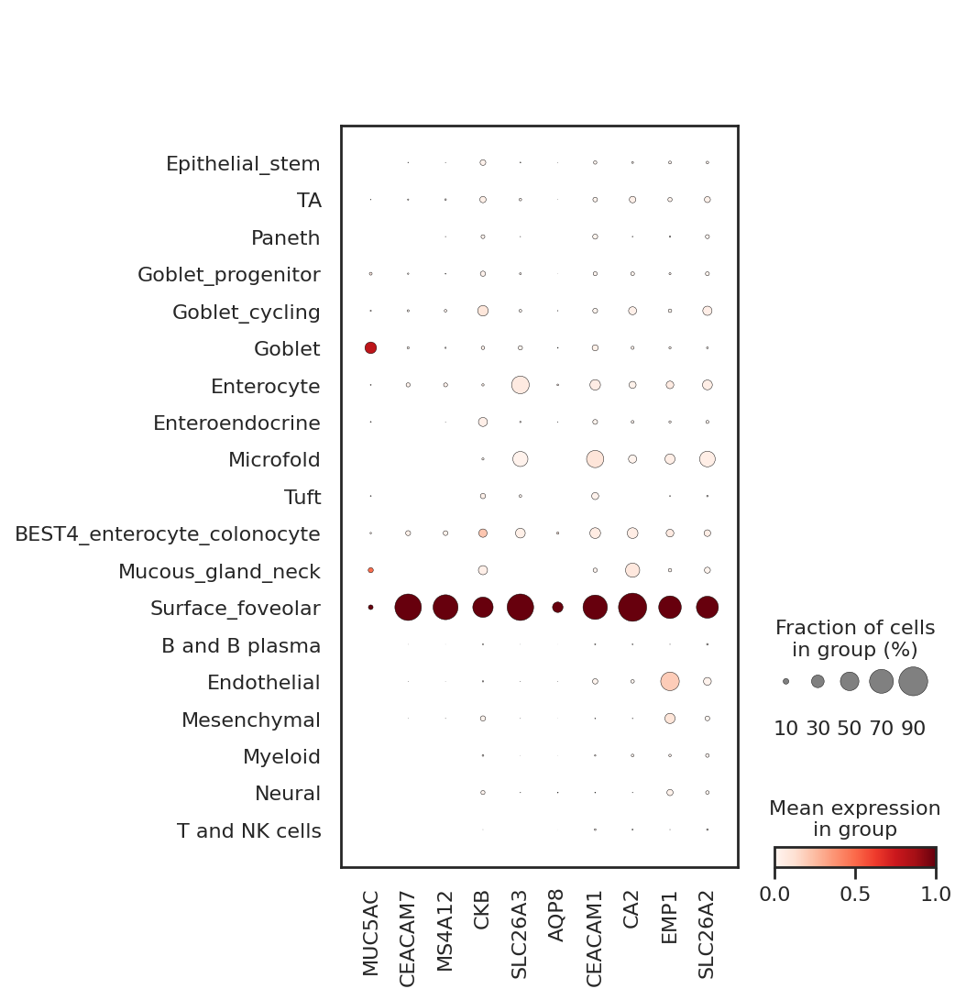

In [44]:
sc.pl.dotplot(adata_raw, ['MUC5AC',
 'CEACAM7',
 'MS4A12',
 'CKB',
 'SLC26A3',
 'AQP8',
 'CEACAM1',
 'CA2',
 'EMP1',
 'SLC26A2'], groupby="level_cNMF_annot", standard_scale="var")